# Computer Vision - Project 1
Image representation and preprocessing

---
- Bartosz Stachowiak 148259 
- Andrzej Kajdasz    148273



### Agenda
- 1. Image Analysis
- 2. Purifiaction:
  - a. Histogram Method
  - b. Mean Pixel Distance and Channel Intensity Method
  - d. Comparison and Tweaks
- 3. Failed Attempts:
  - ...

### Imports & Utilities

In [1]:
%matplotlib inline
import io

import cv2
import numpy as np
import PIL.Image

from matplotlib import pyplot as plt
from IPython.display import Image, display

from transform import purifier, weights, masks, stat

In [2]:
def showarray(img, converted: int | None = cv2.COLOR_BGR2RGB) -> None:
    if converted is not None:
        img = cv2.cvtColor(img, converted)
    f = io.BytesIO()
    PIL.Image.fromarray(np.clip(img.astype(np.uint8), 0, 255)).save(f, "png")
    display(Image(data=f.getvalue()))

def show_image_color_density_plot(image: np.ndarray, ax: plt.Axes) -> None:
    histograms = stat.create_image_histogram(image).T
    densities = histograms / np.repeat(np.sum(histograms, axis=1), 256).reshape(3, 256)

    ax.plot(densities[0], color="blue")
    ax.plot(densities[1], color="green")
    ax.plot(densities[2], color="red")

### Image Download

## 1. Image Analysis

Cathedral Set


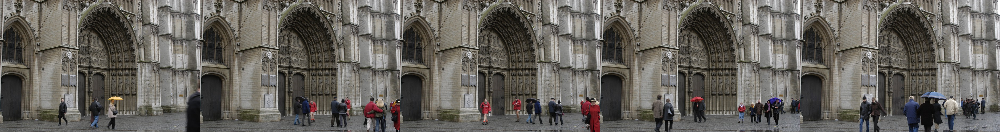

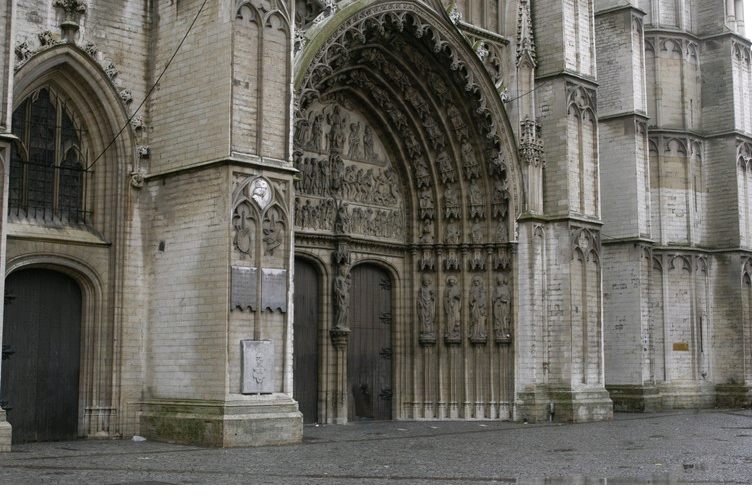



Airport Set


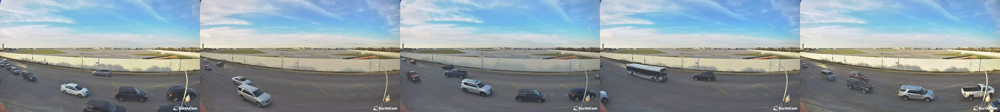

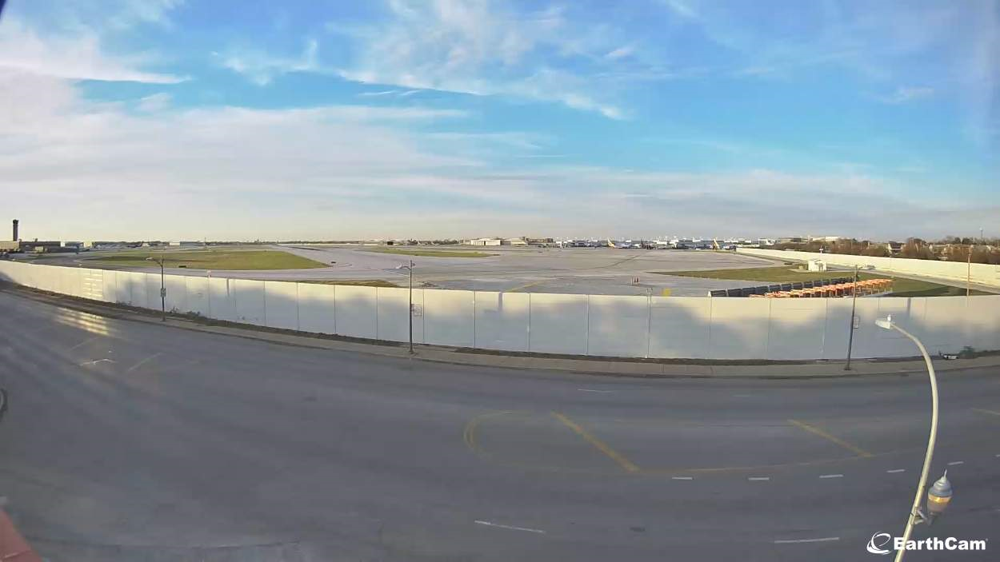

In [3]:
titles = [f"d00{i+1}.jpg" for i in range(5)]
cathedral_images = [cv2.imread(f"data/{title}") for title in titles]
cathedral_result = cv2.imread(f"data/result.png")

airport_images = [cv2.imread(f"data_2/{title}") for title in titles]
airport_result = cv2.imread(f"data_2/result.png")
print("Cathedral Set")
showarray(np.concatenate(cathedral_images, axis=1))
showarray(cathedral_result)
print("\n\nAirport Set")
showarray(np.concatenate(airport_images, axis=1))
showarray(airport_result)

### a. Initial Observations

#### Cathedral Set
- Undesired entities exclusively in the bottom part of the image.
- Many entities are of distictively red/blue colors.
- Background area is mostly in similar (gray-ish) shade.

#### Airport Set:
- Due to slight offset with timestamps the sky and wall shadows have small alterations between the images.
- Entities present on the lower half of the pictures on mostly color-cohesive background.
- Total background area is more diverse than in the cathedral set. 

### b. Images Covering

#### Changing Region

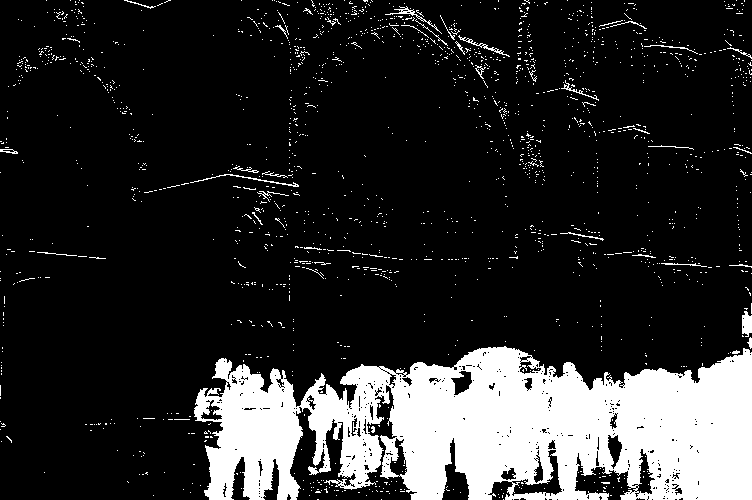

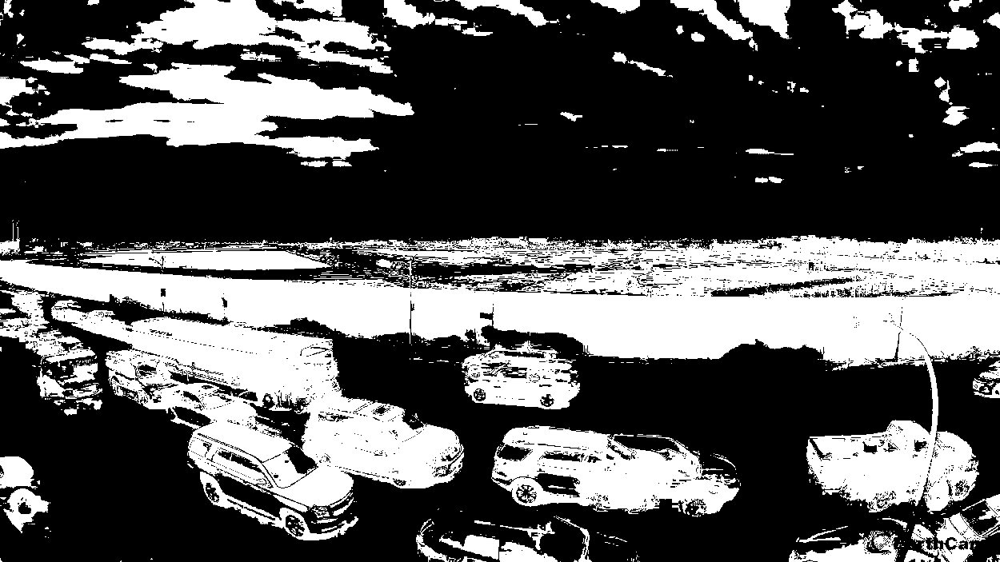

In [4]:
masks.get_changing_mask(cathedral_images, 10)

showarray(masks.get_changing_mask(cathedral_images, 40)*255, None)
showarray(masks.get_changing_mask(airport_images, 40)*255, None)

### Changing region weighted

Very bright areas are different between a greater number of images, black areas are the same in all images.

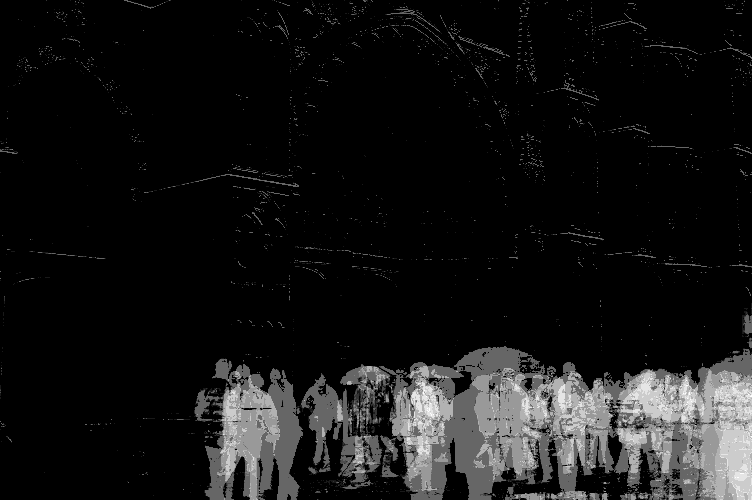

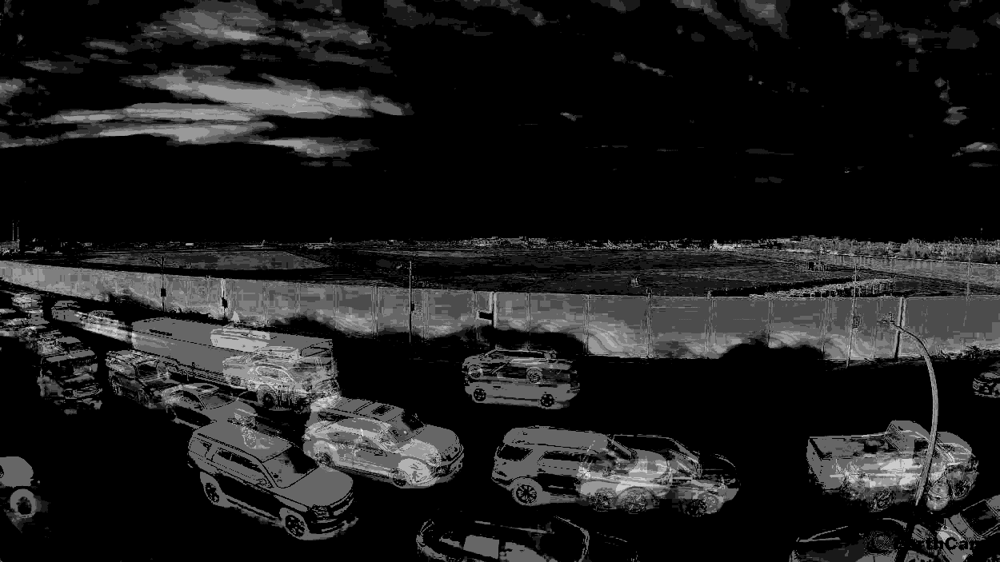

In [5]:
cat_mask = masks.get_changing_mask(cathedral_images, 40, bool_mask=False) 
cat_mask /= np.max(cat_mask)
air_mask = masks.get_changing_mask(airport_images, 40, bool_mask=False) 
air_mask /= np.max(air_mask)
showarray((cat_mask*255).astype(np.uint8), None)
showarray((air_mask*255).astype(np.uint8), None)

Differences in the sky and shadow changes heavily influence the detected changing region, we will see how it will influence the result.

### c. Images Color Density

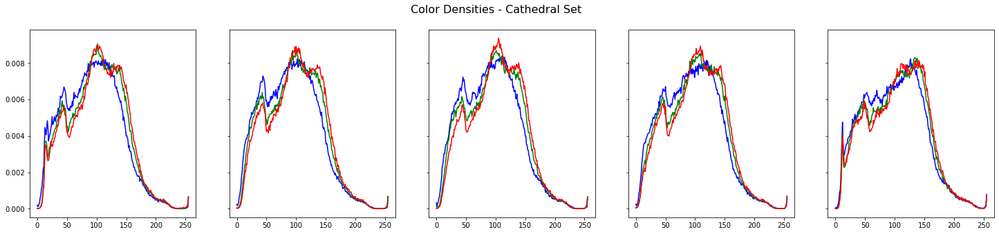

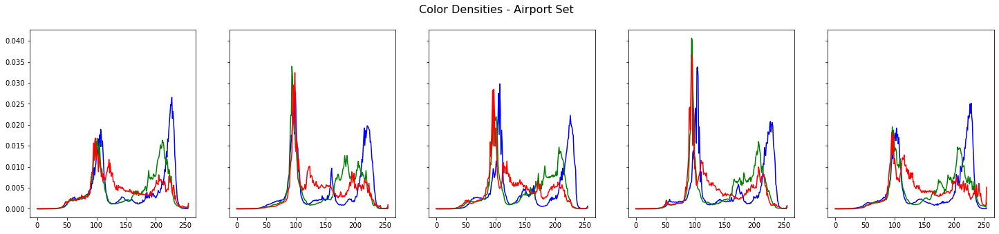

In [6]:
fig, ax = plt.subplots(1, len(cathedral_images), figsize=(25, 5), sharey=True)
for i, image in enumerate(cathedral_images):
    show_image_color_density_plot(image, ax[i])
fig.suptitle("Color Densities - Cathedral Set", fontsize=16)

fig_2, ax_2 = plt.subplots(1, len(cathedral_images), figsize=(25, 5), sharey=True)
for i, image in enumerate(airport_images):
    show_image_color_density_plot(image, ax_2[i])
fig_2.suptitle("Color Densities - Airport Set", fontsize=16)
plt.show()

- The two sets consist of very different color schemes.
- The Airport set is characterized by higher inconsistency in its color channel distributions.

#### Mean Channel Values and Image Standard Deviation

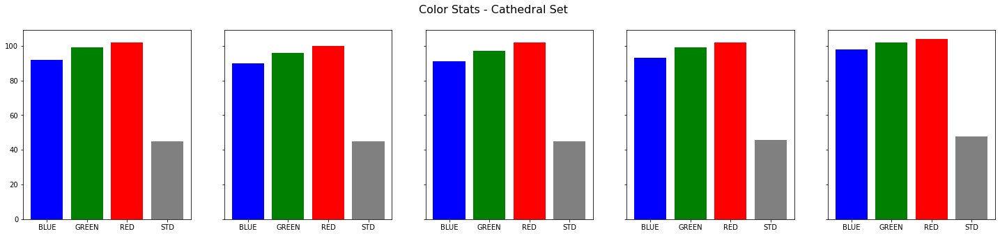

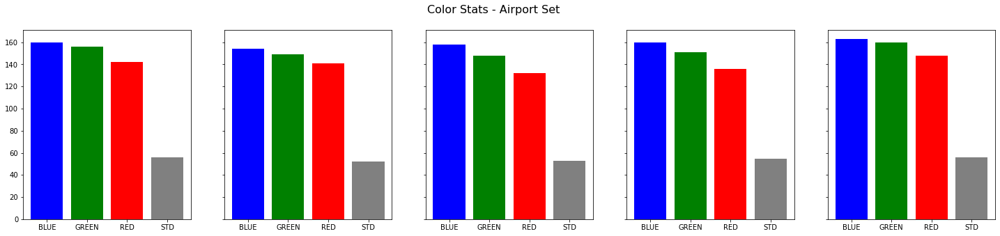

In [32]:
fig, ax = plt.subplots(1, len(cathedral_images), figsize=(25, 5), sharey=True)
for axes, image in zip(ax, cathedral_images):
    b, g, r = np.mean(image, axis=(0, 1)).astype(np.uint8)
    std = np.std(image)
    axes.bar(range(4), [b, g, r, std], color=["blue", "green", "red", "gray"])
    axes.set_xticks(range(4))
    axes.set_xticklabels(["BLUE", "GREEN", "RED", "STD"])
fig.suptitle("Color Stats - Cathedral Set", fontsize=16)

fig_2, ax_2 = plt.subplots(1, len(cathedral_images), figsize=(25, 5), sharey=True)
for axes, image in zip(ax_2, airport_images):
    b, g, r = np.mean(image, axis=(0, 1)).astype(np.uint8)
    std = np.std(image)
    axes.bar(range(4), [b, g, r, std], color=["blue", "green", "red", "gray"])
    axes.set_xticks(range(4))
    axes.set_xticklabels(["BLUE", "GREEN", "RED", "STD"])
fig_2.suptitle("Color Stats - Airport Set", fontsize=16)
plt.show()

- All images within the same set similar color stats have very similar color stats (according to expectation) - Redundant objects contribute to the lesser part of an image than the background.
- Airport set has inverted order of dominating color in comparison to Cathedral set.
- Average values for Airport set are higher than the average ones for Cathedral set.
- Images in both sets have similar standard deviation.

### d. Images statistics

#### Mean and median results

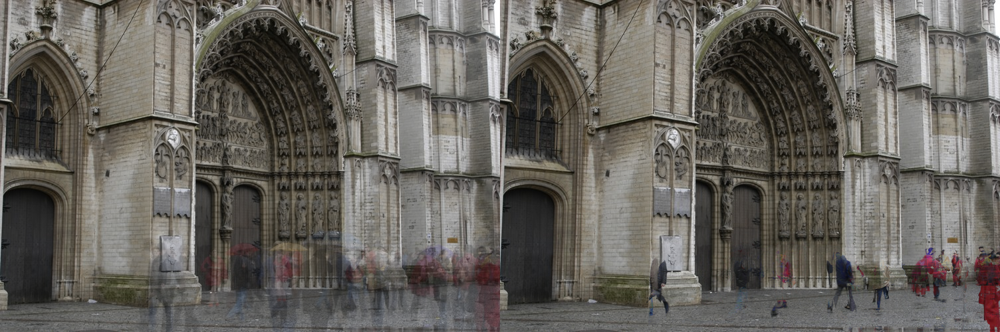

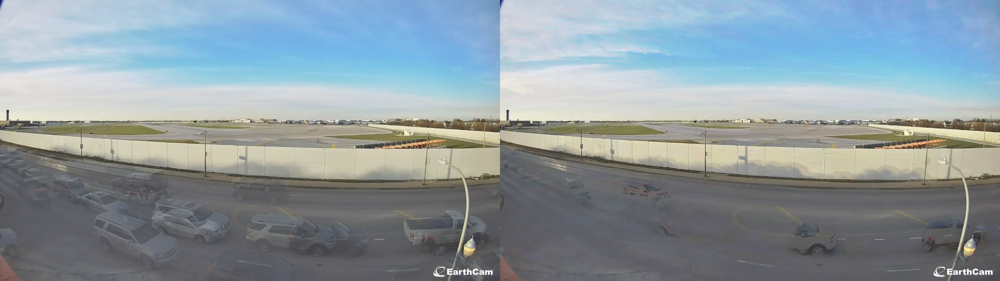

In [19]:
cat_mean = np.mean(cathedral_images, axis=0).astype(np.uint8)
cat_median = np.median(cathedral_images, axis=0).astype(np.uint8)
air_mean = np.mean(airport_images, axis=0).astype(np.uint8)
air_median = np.median(airport_images, axis=0).astype(np.uint8)
showarray(np.concatenate([cat_mean, cat_median], axis=1))
showarray(np.concatenate([air_mean, air_median], axis=1))

For both sets the median image already yields a relatively pure image. We will use it as a reference point further in the comparison.

---

## 2. Purification

In [7]:
cathedral_purifier_max = purifier.ImagesPurifier(cathedral_images, use_max_merge=True)
cathedral_purifier_mean = purifier.ImagesPurifier(cathedral_images, use_max_merge=False)
airport_purifier_max = purifier.ImagesPurifier(airport_images, use_max_merge=True)
airport_purifier_mean = purifier.ImagesPurifier(airport_images, use_max_merge=False)

### a. Histogram Method

#### Description

The first 2 steps of this approach are based on the *[fill in paper name]*.

It works in the following way:
- For each image calculate the histogram of color channels.
- Based on histograms, for each pixel evaluate its weight by multiplying each channels' value probability of that pixel.
- Weights are normalized to be in interval [0, 1].
- To improve results, based on initial analysis, for each weight we subtract the corresponding pixels' normalized standard deviation.
  This favors pixels that do not have any of the color channels stand out in a significant way from the other channels.
- Based on final weights, merge images on desired schema (max weight or weighted mean).

c:\Users\sbart\OneDrive - put.poznan.pl\Semestr V\Computer Vision\Project 1\transform\weights.py:83: RuntimeWarning: invalid value encountered in true_divide
  np.sum(np.array(images) * weights_broadcasted, axis=0) / summed_weights


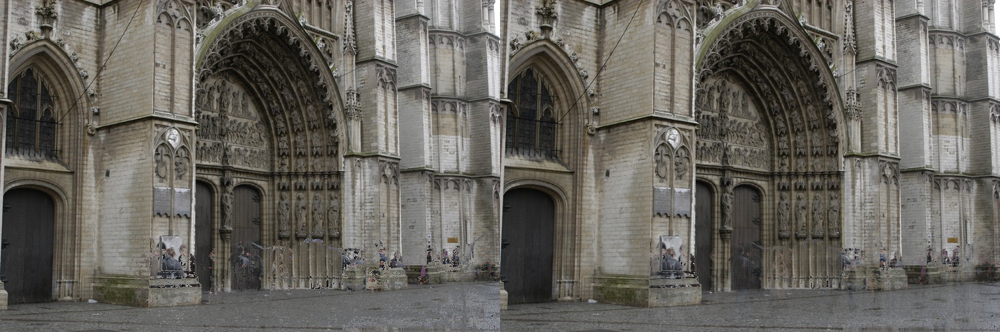

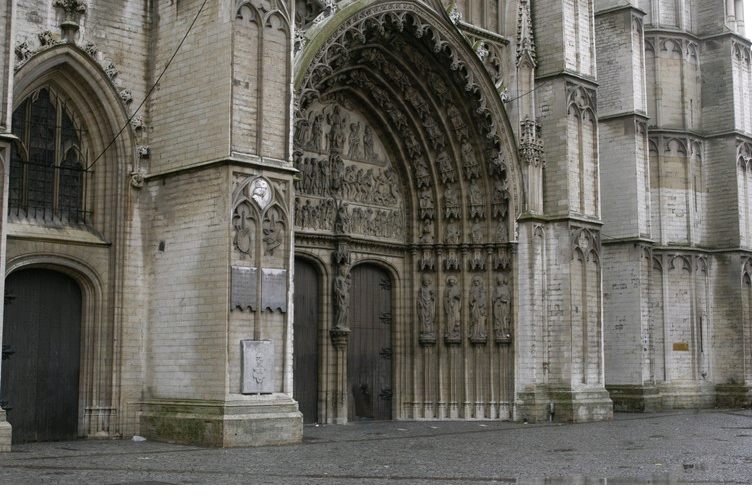

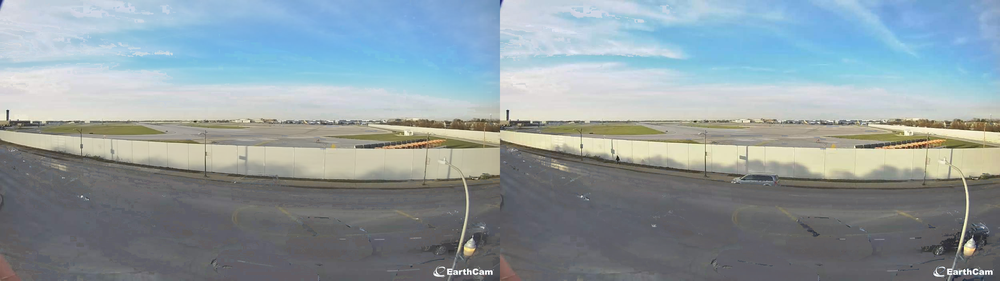

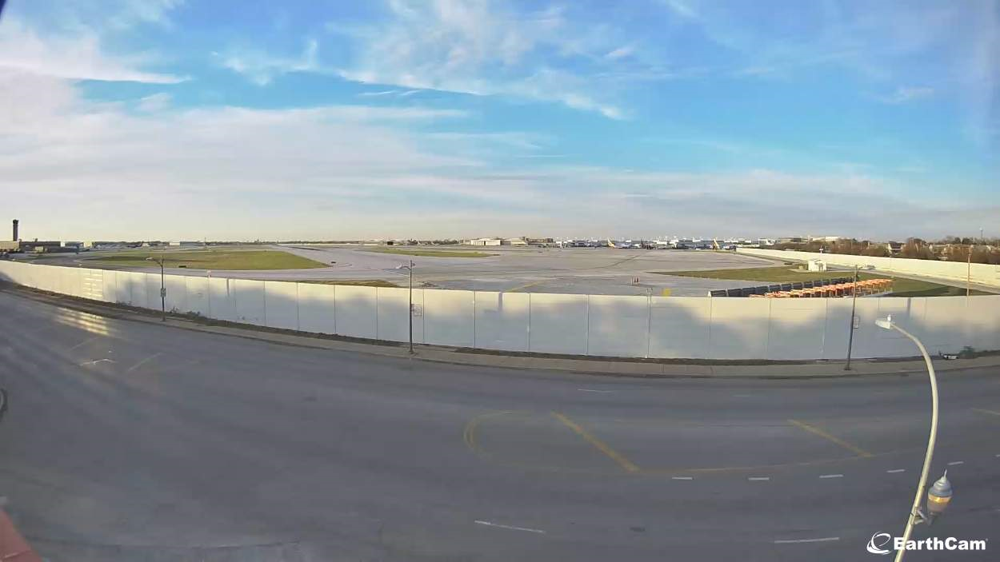

In [8]:
cat_prob_results = [cathedral_purifier_max.purify_with_pixel_probability(), cathedral_purifier_mean.purify_with_pixel_probability()]
air_prob_results = [airport_purifier_max.purify_with_pixel_probability(), airport_purifier_mean.purify_with_pixel_probability()]

showarray(np.concatenate(cat_prob_results, axis=1))
showarray(cathedral_result)
showarray(np.concatenate(air_prob_results, axis=1))
showarray(airport_result)

#### Advantages
- Relatively simple algorithm
- Removes most of the undesired elements
- Performed well on both datasets
#### Drawbacks
- It contains implicit assumption that the background pixels do not have too high standard deviation (i.e. are in the gray-ish colorscale).
- Fails at removing some parts of undesired elements that are in gray-ish colorscale.

---

### b. Mean Pixel Distance and Channel Intensity Method

#### Description

This method works by calculating the masks of distances to the mean pixel value that are higher than a given threshold and then merging them with corresponding high channel intensity masks - that is, masks denoting whether in a given pixel any of the color channels stands out more than the other two (is higher than given tolerance). It should very accurately remove entities that are of colors that stand out from the background, or have high intensity of one color - the motivation for the latter being high color intensity of people clothing in the cathedral set.

The exact steps are as follows:
- Calculate the mean pixel value of all the images.
- For each image, calculate the distance mask from the mean pixel value higher than a given threshold.
- For each image, calculate the high channel intensity mask, that is, mask where True denotes a pixel with one of the channels having a higher value from the other two than a given tolerance.
- Merge the two mask sets together with logical or.
- For each merged mask obtain weight by performing Gaussian blur on it.
- Inverse the final weights (subtract them from 1) so that the low values denote high likelyhood of an entity being in the corresponding pixel.
- Based on final weights, merge images on desired schema (max weight or weighted mean).

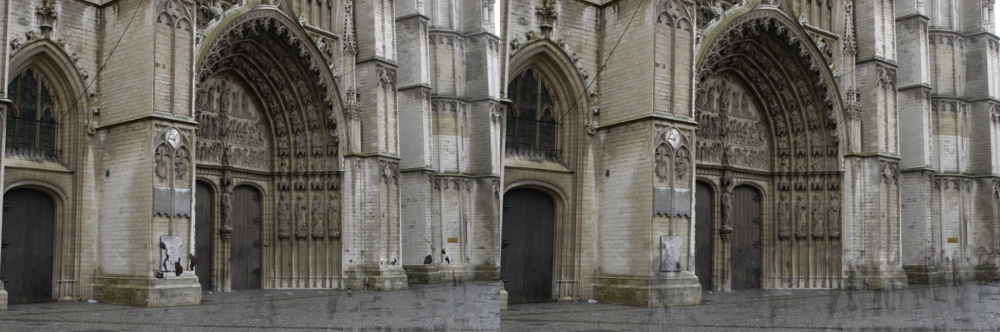

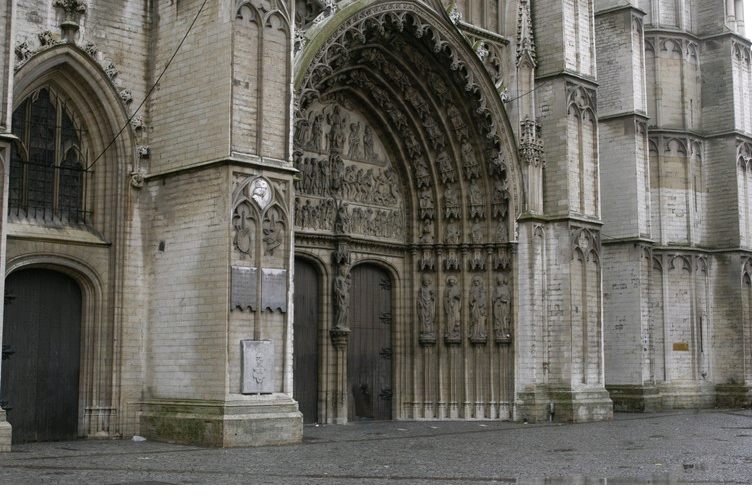

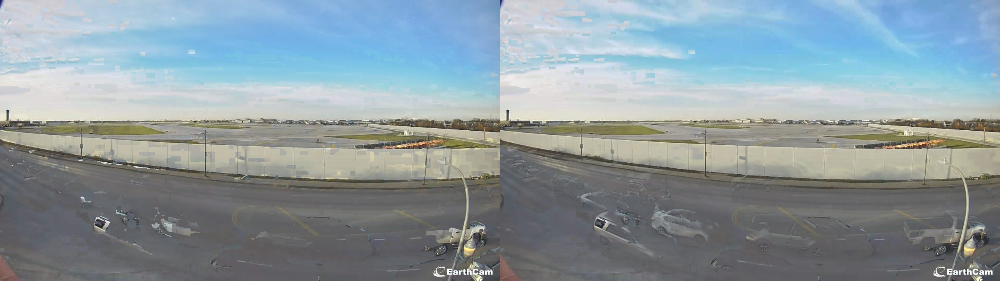

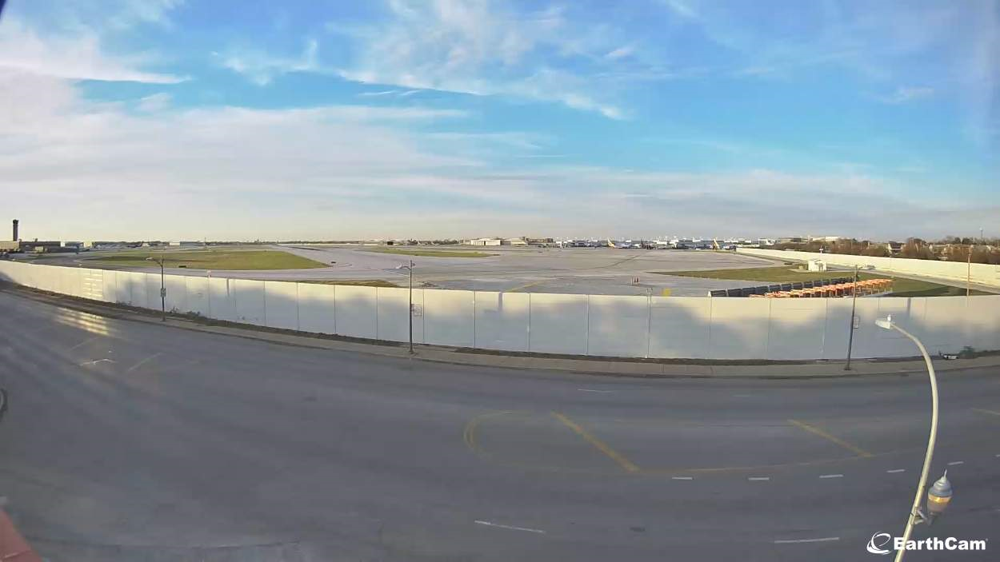

In [9]:
cat_dist_results = [cathedral_purifier_max.purify_with_mean_pixel_distance_and_channel_intensity(), cathedral_purifier_mean.purify_with_mean_pixel_distance_and_channel_intensity()]
air_dist_results = [airport_purifier_max.purify_with_mean_pixel_distance_and_channel_intensity(), airport_purifier_mean.purify_with_mean_pixel_distance_and_channel_intensity()]

showarray(np.concatenate(cat_dist_results, axis=1))
showarray(cathedral_result)
showarray(np.concatenate(air_dist_results, axis=1))
showarray(airport_result)

#### Advantages
- Works very well for the cathedral set, and quite well for the airport set.
- Very good at removing distinctive objects (even if they cover the background at the same place in several pictures).
#### Drawbacks
- May generalize poorly - contains two implicit assumptions:
  - Entities that are to be removed have higher color intensity on one of the channels
  - Entities that are to be removed do not take most of the picture and are of different color palette than the background.
---

### c. Comparison and tweaks

All results together

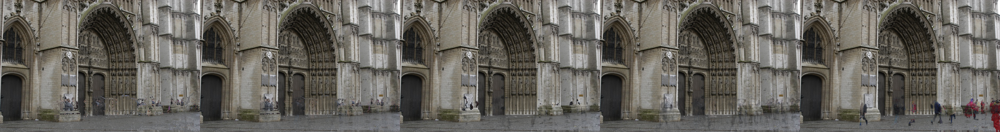

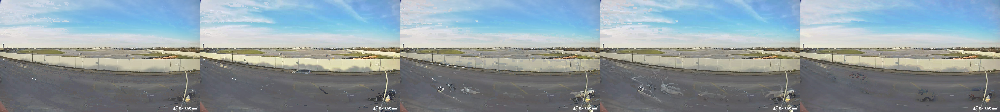

In [22]:
cat_all_results = [*cat_prob_results, *cat_dist_results, cat_median]
air_all_results = [*air_prob_results, *air_dist_results, air_median]
showarray(np.concatenate(cat_all_results, axis=1))
showarray(np.concatenate(air_all_results, axis=1))

The Mean Pixel Distance and Color Channel Intensity Method works better for the Cathedral dataset whilst the Histogram Method is superior for the Airport dataset.

Both methods remove vast majority of the undesired objects.

We can combine obtained results by median:

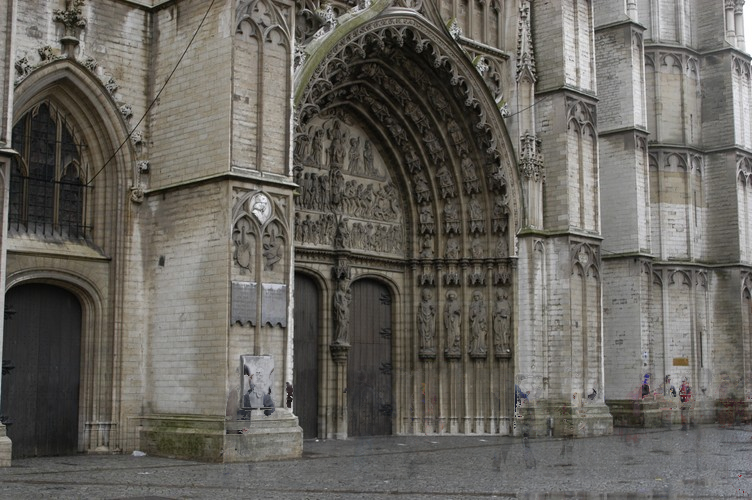

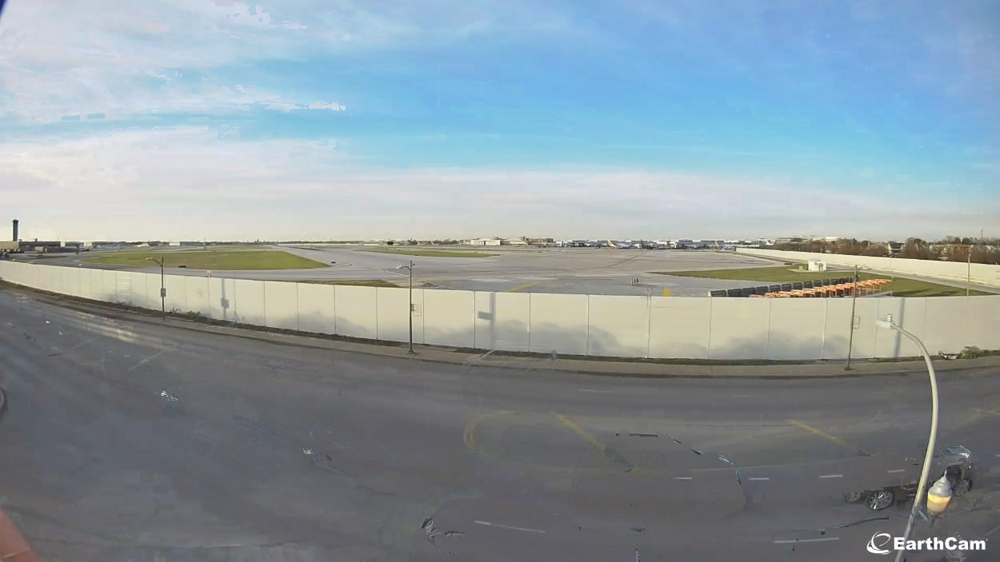

In [23]:
showarray(stat.get_median_image(cat_all_results))
showarray(stat.get_median_image(air_all_results))

Or by mean:

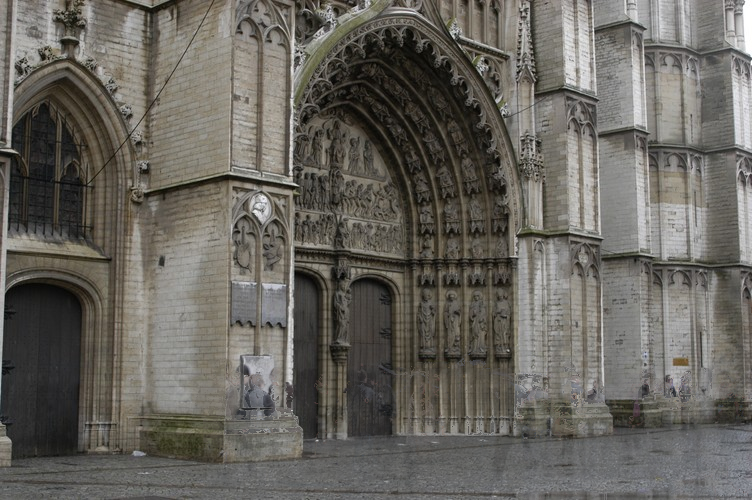

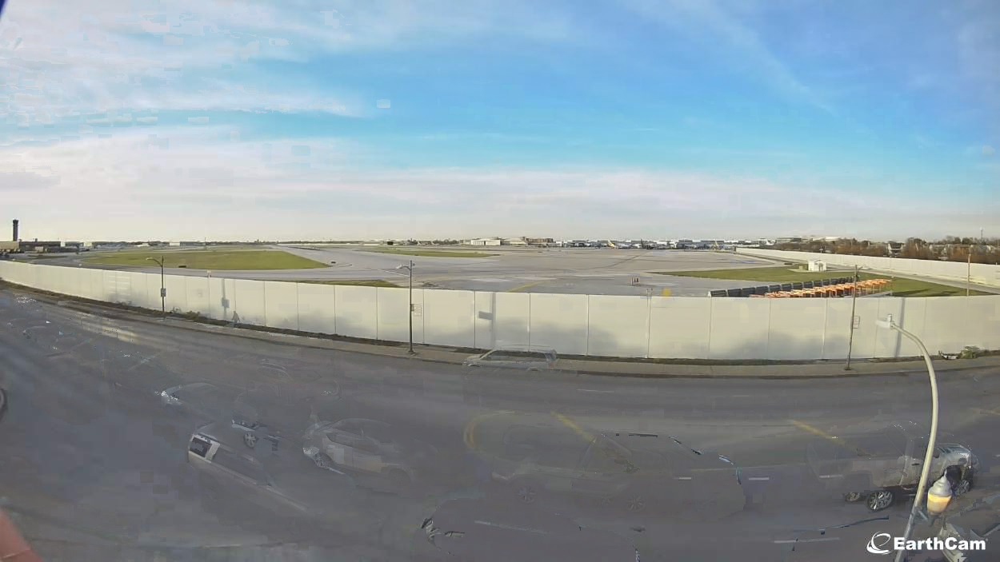

In [17]:
showarray(np.mean(cat_all_results, axis=0).astype(np.uint8))
showarray(np.mean(air_all_results, axis=0).astype(np.uint8))

## 3. Failed Attempts

### a. Edge Weight Method

#### Description

The basis of the algorithm is the fact that the unconcealed entities usually stand out on their direct background - there is an edge between them.
We can exploit that by treating the inverted results of edge detection algorithm as weights - the background edges will appear on every weight map with similar value hence won't be affected, whilst the edges of moving objects should appear on singular images, in which case the algorithm will choose the images in which these edges do not appear, thus removing the entities from the image.

Algorithm works as follows:
- For each image, calculate its weight by running a Canny edge detection algorithm.
- Each normalize each edge detection result and normalize it by subtracting it from 1and treat as weight.
- Based on these weights, merge images on desired schema (max weight or weighted mean).

c:\Users\sbart\OneDrive - put.poznan.pl\Semestr V\Computer Vision\Project 1\transform\weights.py:80: RuntimeWarning: invalid value encountered in true_divide
  weights_norm = weights_stacked / np.atleast_3d(np.sum(weights_stacked, axis=2))


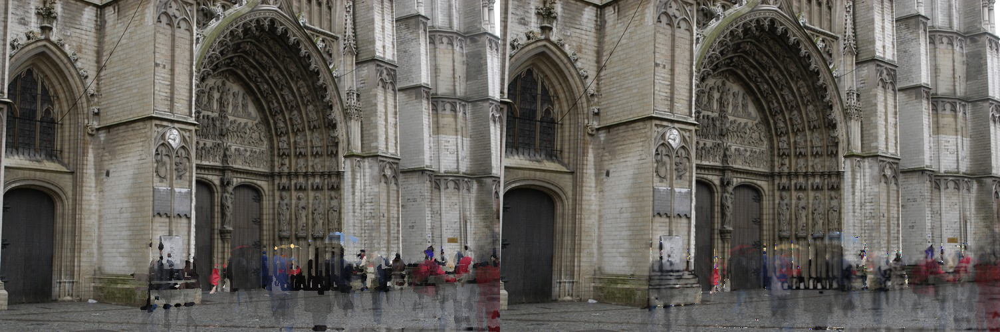

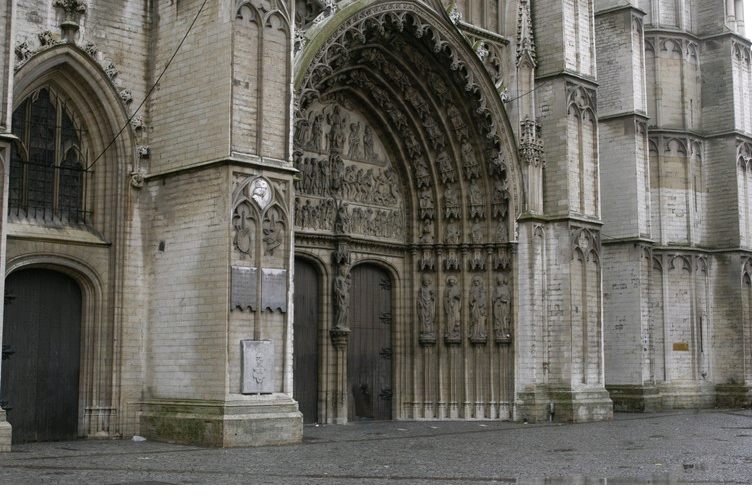

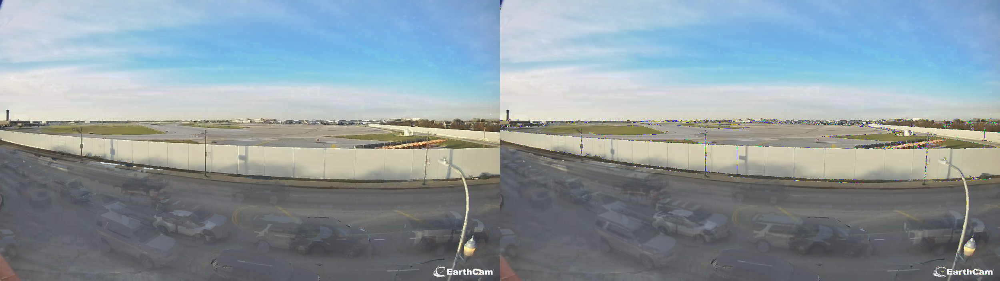

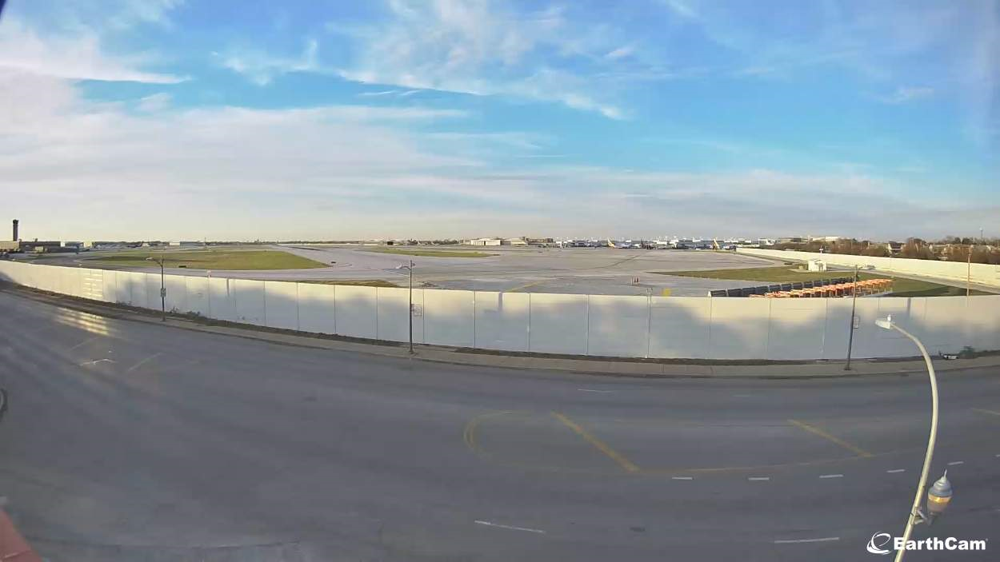

In [9]:
cat_edge_results = [cathedral_purifier_max.purify_with_edge_weight(), cathedral_purifier_mean.purify_with_edge_weight()]
air_edge_results = [airport_purifier_max.purify_with_edge_weight(), airport_purifier_mean.purify_with_edge_weight()]

showarray(np.concatenate(cat_edge_results, axis=1))
showarray(cathedral_result)
showarray(np.concatenate(air_edge_results, axis=1))
showarray(airport_result)